# Analyzing NIH grant abstracts to predict total funds awarded

Our goal is to attempt to predict how much funding a grant is awarded based on the grant abstract and the number of years a grant is funded. We will also identify funding/research trends over the years. The code to obtain these data and perform initial cleaning can be found [here](download-clean-data.ipynb).

Here we will perform preprocessing of the abstract text data.

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import nltk
from nltk.tokenize import WhitespaceTokenizer
from nltk.tokenize import RegexpTokenizer
from nltk.text import Text
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
import string

from sklearn.externals import joblib
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.manifold import TSNE

from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import f1_score

pd.set_option('display.max_columns', 50)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

[Local functions](https://github.com/yuwie10/nih-awards/blob/master/nih_functions.py) for this project.

In [2]:
import nih_functions as nih
import importlib as imp
imp.reload(nih);

First we load the dataset with abstract information.

In [3]:
cols = pd.read_csv('phr.csv', compression = 'gzip', nrows = 1)

dates = ['project_start', 'project_end']
numeric = ['funds', 'support_year', 'num_pis']

#get dtypes
dtypes = nih.get_dtypes(cols, numeric)

phr = pd.read_csv('phr.csv', compression = 'gzip',
                  dtype = dtypes, parse_dates = dates)

Let's explore the abstract column a little.

In [4]:
phr['phr'] = phr['phr'].str.strip()

In [5]:
phr['phr'].head()
phr['phr'].tail()

0    we have previously shown that 30-year old trea...
1    the proposed research will be directly relevan...
2    public health relevance statement liver toxici...
3    habitual alcohol drinking and cue-induced rela...
4    alcohol addiction is a chronically relapsing d...
Name: phr, dtype: object

191121    project narrative pancreatic tumors have a set...
191122    project narrative trauma-exposed adolescents a...
191123    narrative nicotine addiction is the leading pr...
191124    public health relevance: hepatocarinoma is a m...
191125    public health relevance:  trip13 overexpressio...
Name: phr, dtype: object

Many of the abstracts begin with the strings 'project narrative' or 'public health relevance'. Let's first remove these phrases and any extraneous white spaces.

In [6]:
def strip_begin(s, text):
    if s.startswith(text):
        return s[len(text):]
    return s

In [7]:
strings = ['public health relevance', ' statement', 'project narrative', 'narrative']

phr_list = []
for s in phr['phr']:
    for idx, _ in enumerate(strings):
        s = strip_begin(s, strings[idx])
    phr_list.append(s)

There are several entries where instead of white spaces, words are separated by a closed parenthesis ')'. We will need to replace these symbols with 

In [8]:
phr.loc[[15027]]

,application_id,activity,application_type,arra_funded,funding_mechanism,fy,nih_spending_cats,phr,project_start,project_end,project_terms,study_section,study_section_name,support_year,funds,pi_ids,num_pis
15027,7985190,r01,2,n,research projects,2010,neurosciences;eye disease and disorders of vis...,this)grant)proposal)will)address)the)function)...,1984-08-01,2013-08-31,address;amacrine cells;analog;applications gra...,bdpe,biology and diseases of the posterior eye,27.0,395192.0,1933612,1.0


In [9]:
for idx, s in enumerate(phr_list):
    #there will be a lot of abbreviations, so ignore these parantheses
    if '(' not in s:
        phr_list[idx] = s.replace(')', ' ')

Check that the list of cleaned abstracts is the same length as the dataframe.

In [10]:
len(phr_list)
len(phr)

191126

191126

Add the cleaned abstracts to the dataframe.

In [11]:
phr['phr_cleaned'] = phr_list
#del phr['phr']

In [12]:
phr['phr_cleaned'] = phr['phr_cleaned'].str.strip(': ')

In [13]:
phr.head()

,application_id,activity,application_type,arra_funded,funding_mechanism,fy,nih_spending_cats,phr,project_start,project_end,project_terms,study_section,study_section_name,support_year,funds,pi_ids,num_pis,phr_cleaned
0,7582101,r01,2,NaN,NaN,2008,alcoholism;basic behavioral and social science...,we have previously shown that 30-year old trea...,2002-06-01,NaT,"1,3,7-trimethylxanthine;1h-purine-2,6-dione, 3...",nal,neurotoxicology and alcohol study section,6.0,620924.0,7356212,1.0,we have previously shown that 30-year old trea...
1,7620149,r01,1,NaN,NaN,2008,alcoholism;behavioral and social science;infec...,the proposed research will be directly relevan...,2008-09-30,NaT,aids;aids virus;absolute ethanol;acquired immu...,ace,aids clinical studies and epidemiology study s...,1.0,329599.0,8616018,1.0,the proposed research will be directly relevan...
2,7589274,r01,1,NaN,NaN,2008,alcoholism;chronic liver disease and cirrhosis...,public health relevance statement liver toxici...,2008-09-30,NaT,"3-heptanone, 6-(dimethylamino)-4,4-diphenyl-;6...",zaa1,special emphasis panel,1.0,437882.0,1891463,1.0,liver toxicity in hiv disease is a common occu...
3,7590863,r01,1,NaN,NaN,2008,alcoholism;basic behavioral and social science...,habitual alcohol drinking and cue-induced rela...,2008-09-30,NaT,"3,4-dihydroxyphenethylamine;3,4-dihydroxypheny...",zaa1,special emphasis panel,1.0,279236.0,6608090,1.0,habitual alcohol drinking and cue-induced rela...
4,7590746,r01,1,NaN,NaN,2008,alcoholism;basic behavioral and social science...,alcohol addiction is a chronically relapsing d...,2008-09-30,NaT,"8-azabicyclo(3.2.1)octane-2-carboxylic acid, 3...",zaa1,special emphasis panel,1.0,402688.0,1862383,1.0,alcohol addiction is a chronically relapsing d...


For this analysis we are not investigating grants awarded per PI or per institution. Therefore we can drop duplicate grants (identified by application_id, which is unique per year) and multiply the funding column by the number of PIs to get total funding awarded per individual grant. Also we will drop any rows where the funding information is not available.

In [14]:
phr = phr.drop_duplicates('application_id')
phr['funds'] = phr['funds'] * phr['num_pis']
phr = phr.ix[phr['funds'].notnull()]

## Word frequencies
In this section we isolate the top 10 most frequent words in each abstract. Although the frequent word list gives a clear indication of the topic of the grant, using frequent words to train a classifier gives inferior results to tf-idf.

In [211]:
common_list = []
common_words = []
for i, text in enumerate(all_text):
    freq = nltk.FreqDist(text)
    top_10 = freq.most_common(10)
    common_words.append([(word[0] + ' ') * word[1] for word in top_10])
    
    #generates list that can be converted to a df for easy viewing
    if len(top_10) < 10:
        common_list.append([None] * 10)
    else:
        common_list.append([word[0] for word in top_10])

#transform to string so can be vectorized using CountVectorizer
common_words = nih.list_to_string(common_words)        

In [214]:
cols = ['first', 'second', 'third', 'fourth', 'fifth', 
        'sixth', 'seventh', 'eighth', 'ninth', 'tenth']
most_common = pd.DataFrame(common_list, columns = cols)

In [243]:
most_common.sample(5)

,first,second,third,fourth,fifth,sixth,seventh,eighth,ninth,tenth
151596,channel,molecular,ion,expand,understanding,level,specialized,membrane,protein,called
131955,vision,implant,patient,blind,currently,clinical,available,level,tool,train
30381,development,cancer,polyoma,papillomaviruses,infectious,pathogen,linked,human,studying,way
97312,antibody,rituximab,therapy,therapeutic,response,majority,non-hodgkin,lymphoma,treated,monoclonal
22003,disease,adult,u,life,patient,development,therapy,noninvasive,measure,mri


## Tf-idf

In [15]:
all_text = phr['phr_cleaned'].tolist()

Let's get a sense of the lengths of our abstracts (this includes punctuation and stop words).

In [16]:
lengths = pd.DataFrame([len(s) for s in all_text])
lengths.describe()

,0
count,163532.000000
mean,596.803782
std,329.296318
min,1.000000
25%,425.000000
50%,540.000000
75%,689.000000
max,21214.000000


For tf-idf analysis, we need to tokenize and stem our text. We will use NLTK's RegexpTokenizer to remove non-alphanumeric symbols and will test lemmatization and stemming.

In [16]:
#removes any non-alphanumeric symbols
tokenizer = RegexpTokenizer(r'\w+')
lemmatizer = WordNetLemmatizer()
stemmer = SnowballStemmer('english')

In [17]:
def get_tokens_stems(text, tokenizer = tokenizer,
                     stem = True, stemmer = stemmer,
                     lemma = False, lemmatizer = lemmatizer):
    
    #get tokens
    all_text = tokenizer.tokenize(text)
    
    if lemma:
        #get word lemmas
        all_text = [lemmatizer.lemmatize(word) for word in all_text]
    
    if stem:
        #get word stems
        all_text = [stemmer.stem(word) for word in all_text]
    
    return all_text

Lemmatization and stemming results in mapping of potentially many words to the lemma/stem. We want to be able to look up the words associated with a particular lemma/stem for future reference. Therefore let's map words to their corresponding stemmed version.

In [19]:
def map_words_to_stems(list_words, list_roots):
    
    '''
    Given a list of words and list of lemmas/stems,
    return a dictionary with the lemma/stem as keys
    and a list of words with that lemma/stem as values
    '''
    
    dict_roots = {}
    for word, root in zip(list_words, list_roots):
        
        #we don't need to store the word if it is not stemmed
        if root != word:
            
            #if the lemma/stem is already a key in the dictionary
            if root in dict_roots:
                
                #if the word is not already listed
                if word not in dict_roots[root]:
                    dict_roots[root].append(word)
            else:
                #add lemma/stem as key and word as value
                dict_roots[root] = [word]
    
    return dict_roots

In [36]:
for text in all_text:
    
    #get list of tokenized words and lemmas/stems
    #for each abstract
    list_words = get_tokens_stems(text, stem = False)
    list_lemmas = [lemmatizer.lemmatize(word) for word in list_words]
    list_stems = [stemmer.stem(word) for word in list_words]

dict_lemmas = map_words_to_stems(list_words, list_lemmas)
dict_stems = map_words_to_stems(list_words, list_stems)

In [87]:
len(dict_lemmas)
len(dict_stems)

4358

15960

There are far fewer lemmas than stemmed roots. If we examine the lemmas we see that it seems to mostly be shortening plural words to their singular forms. We will have to be cognizant that our lemmatizer stemmed abbreviations, including transforming 'aids' (AIDS) to 'aid' and 'us' (US) to 'u'.

Stemming using the snowball stemmer, on the other hand, seems to better handle different tenses and forms of words, so we will use the snowball stemmer. Let's save both dictionaries as JSON files for future reference.

In [18]:
import json

#uncomment to write dicts to JSON files
#with open('lemmas.txt', 'w') as outfile:
#    json.dump(dict_lemmas, outfile)

#with open('stems_snowball.txt', 'w') as outfile:
#    json.dump(dict_stems, outfile)

#read JSON files
with open('stems_snowball.txt', 'r') as json_data:
    dict_stems = json.load(json_data)

Let's also create a dataframe with all the vocabulary in the NIH abstract corpus following stemming.

In [19]:
vocab = []
for text in all_text:
    vocab.append(get_tokens_stems(text))

vocab = [item for sublist in vocab for item in sublist]

all_vocab = pd.DataFrame({'vocab':vocab})
all_vocab.drop_duplicates(inplace = True)
all_vocab.shape

(35576, 1)

Including stop words, there are over 35,000 unique words in the abstracts, which is relatively small for a text corpus. As the abstracts themselves are short, this is unsurprising.

We will also remove stop words from our corpus. In addition to the normal English stop words, we need to remove common generic research terms. Let's define a list of stop words for the NIH grant abstracts.

In [19]:
research_terms = ['proposal', 'propose', 'proposed', 'involve', 'public', 'health', 
                  'significance', 'significant', 'goal', 'research', 'relevant', 
                  'relevance', 'project', 'narrative', 'study', 'work', 'understand',
                  'result', 'statement', 'address', 'may', 'use', 'unreadable',
                  'investigate', 'investigation', 'also', 'provide', 'new', 'novel',
                  'application', 'approach', 'approximately', 'associated', 'because']

Some of these words should map to the same stems. Let's replace these words with their corresponding stems.

In [20]:
for i, term in enumerate(research_terms):
    for key, values in dict_stems.items():
        if term in values:   
            #replace word with stemmed version
            research_terms[i] = key

#get unique elements in research_terms
research_terms = list(set(research_terms))

Add our research terms to NLTK's stop words list.

In [21]:
stopwords = nltk.corpus.stopwords.words('english')
my_stops = stopwords + research_terms

We can now vectorize our text via tf-idf transformation using our self-defined tokenization/stemming function and stop words list. We will set min_df (the minimum number of documents the word/phrase must appear in to be considered as a feature) to 500, as this seems to give a good balance between identifying words that may be useful for analyzing abstracts without including too many words (features). We also will keep the default ngram_range to be (1, 1), as bigrams and trigrams in our dataset are redundant.

In [22]:
vectorizer = TfidfVectorizer(max_df = 0.8, min_df = 500, stop_words = my_stops,
                             tokenizer = get_tokens_stems, 
                             lowercase = False, max_features = 200000,
                             use_idf = True, ngram_range = (1, 1))

In [226]:
%time tfidf_matrix = vectorizer.fit_transform(all_text)
tfidf_matrix.shape
terms = vectorizer.get_feature_names()

CPU times: user 3min 43s, sys: 592 ms, total: 3min 44s
Wall time: 3min 45s


(163532, 1745)

In [22]:
#joblib.dump(tfidf_matrix, 'tfidf_matrix.pkl')

tfidf_matrix = joblib.load('tfidf_matrix.pkl')

### Clustering
We will use mini-batch K-Means.

In [134]:
num_clusters = 20
batch_size = round(0.05 * tfidf_matrix.shape[0])

km = MiniBatchKMeans(n_clusters = num_clusters,
                     batch_size = batch_size)

%time km.fit(tfidf_matrix)

clusters = km.labels_.tolist()

CPU times: user 3.76 s, sys: 216 ms, total: 3.98 s
Wall time: 4.17 s


MiniBatchKMeans(batch_size=8177, compute_labels=True, init='k-means++',
        init_size=None, max_iter=100, max_no_improvement=10, n_clusters=20,
        n_init=3, random_state=None, reassignment_ratio=0.01, tol=0.0,
        verbose=0)

Save and re-load trained K-Means model.

In [15]:
#joblib.dump(km, 'clusters_km.pkl')

num_clusters = 20
km_fit = joblib.load('clusters_km.pkl')
clusters = km_fit.labels_.tolist()

To see which terms were used to cluster the grants, we can pull out the top ten words closest to the cluster centroids.

In [29]:
#sorted centroids
order_centroids = km_fit.cluster_centers_.argsort()[:, ::-1] 

num_words = 10

cluster_vocab = pd.DataFrame()
for i in range(num_clusters):
    centroid_words = []
    
    #for each cluster, get the words closest to 
    #the cluster center
    for idx in order_centroids[i, :num_words]:
        centroid_words.append(terms[idx])
    cluster_vocab['cluster ' + str(i)] = centroid_words

In [30]:
cluster_vocab

,cluster 0,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,cluster 8,cluster 9,cluster 10,cluster 11,cluster 12,cluster 13,cluster 14,cluster 15,cluster 16,cluster 17,cluster 18,cluster 19
0,alcohol,receptor,brain,hiv,liver,cell,age,patient,children,infect,parasit,heart,gene,imag,lung,diseas,cancer,protein,dna,pathogen
1,smoke,tumor,disord,infect,diseas,stem,sleep,treatment,obes,virus,iron,failur,express,kidney,injuri,mechan,breast,drug,genet,bacteri
2,tobacco,signal,neuron,1,hepat,tumor,relat,pain,intervent,vaccin,malaria,cardiac,diseas,method,inflamm,human,tumor,structur,genom,bacteria
3,cocain,activ,function,aid,fatti,cancer,cognit,improv,risk,immun,drug,diseas,human,develop,diseas,regul,prostat,diseas,human,antibiot
4,addict,target,memori,risk,alcohol,immun,diseas,effect,diabet,viral,infect,caus,regul,diseas,inflammatori,signal,cell,develop,diseas,infect
5,effect,regul,neural,intervent,cancer,diseas,declin,clinic,behavior,cell,diseas,death,mutat,patient,asthma,cell,therapi,target,sequenc,resist
6,abus,cell,circuit,drug,cirrhosi,regul,older,care,adolesc,host,caus,blood,develop,mri,pulmonari,develop,target,function,repair,host
7,drink,mechan,develop,prevent,metabol,develop,function,develop,effect,respons,develop,attack,genet,clinic,mechan,function,develop,biolog,mutat,diseas
8,behavior,therapeut,mechan,transmiss,caus,mechan,increas,therapi,prevent,human,human,lead,identifi,detect,airway,molecular,patient,enzym,cancer,immun
9,treatment,role,cognit,antiretrovir,develop,function,popul,diseas,social,develop,host,mechan,caus,improv,acut,pathway,treatment,membran,chromosom,human


We can immediately see that K-Means identified different research subjects, such as research regarding addiction and addictive substances (cluster 0) and HIV/AIDS research (cluster 3). This is confirmation that our unsupervised clustering was able to identify structure within our abstract data.

We will assign each cluster a label based on the top 10 vocabulary words closest to the cluster centroid. These labels will by definition be rather broad, but they do seem to capture general research categories.

In [16]:
cluster_labels = {
    0:'substance abuse/addiction',
    1:'cell signaling',
    2:'neuroscience',
    3:'hiv',
    4:'liver research',
    5:'cancer cell biology',
    6:'sleep/ageing',
    7:'clinical research',
    8:'child obesity/diabetes',
    9:'virology',
    10:'parasitology (malaria)',
    11:'cardiac research',
    12:'gene expression',
    13:'kidney research and imaging',
    14:'lung research',
    15:'human disease mechanisms',
    16:'cancer research',
    17:'drug development',
    18:'genetics and genomics',
    19:'bacteriology'
}

Let's add the cluster assignments and labels to our original dataframe.

In [17]:
phr['cluster'] = clusters
phr['cluster_labels'] = clusters
phr['cluster_labels'].replace(cluster_labels, inplace = True)

In [100]:
phr['cluster_labels'].value_counts()

human disease mechanisms       21501
clinical research              20042
child obesity/diabetes         13130
neuroscience                   12686
cancer cell biology            11495
cancer research                10889
drug development                9071
gene expression                 7209
genetics and genomics           6244
virology                        6150
kidney research and imaging     6056
lung research                   5900
hiv                             5475
bacteriology                    5245
cell signaling                  4900
sleep/ageing                    4753
substance abuse/addiction       4607
cardiac research                4520
liver research                  2020
parasitology (malaria)          1639
Name: cluster_labels, dtype: int64

Plotting the distribution of funds by abstract cluster (grants with awarded funds greater than $1,000,000 not shown), we see that the peak of the funds by cluster are similar, although it looks like there may be some differences in the shape of the distributions.

/usr/local/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The set_color_cycle attribute was deprecated in version 1.5. Use set_prop_cycle instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


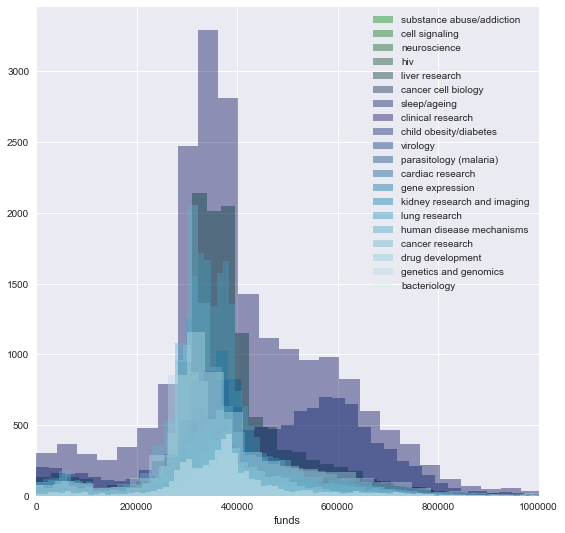

In [103]:
from cycler import cycler

num_colors = 20
cm = plt.get_cmap('ocean')

fig, ax = plt.subplots()
fig.set_size_inches(9, 9);

ax.set_color_cycle([cm(1.*i/num_colors) for i in range(num_colors)])
for i in range(20):
    _ = sns.distplot(phr.ix[phr['cluster'] == i]['funds'],
                     bins = 200, label = cluster_labels[i], kde = False)

_ = plt.legend()
_ = plt.xlabel('funds')
_ = plt.xlim(0, 1000000)

The large degree of overlap makes it difficult to resolve individual grant clusters. Let's visualize the data as violin plots, both with and without extreme values.

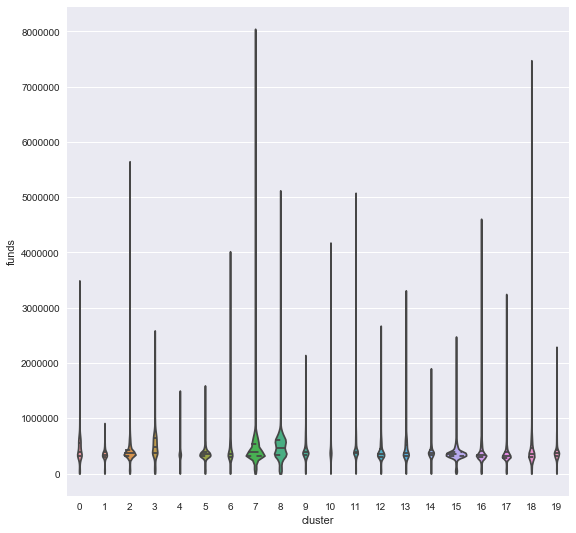

In [115]:
fig, ax = plt.subplots()
fig.set_size_inches(9, 9);
_ = sns.violinplot(x = 'cluster', y = 'funds', data = phr,
                  scale = 'count', inner = 'quartile')

What is the mean amount of funding awarded per grant in each cluster?

In [109]:
phr.groupby('cluster_labels')['funds'].mean().sort_values(ascending = False)

cluster_labels
hiv                            499690.516712
child obesity/diabetes         482591.196116
cardiac research               434476.394248
kidney research and imaging    433162.161328
substance abuse/addiction      432384.346863
clinical research              431154.973406
virology                       423786.623415
genetics and genomics          419941.639174
sleep/ageing                   418262.839470
parasitology (malaria)         404944.325198
bacteriology                   396290.501239
lung research                  393594.535085
neuroscience                   386604.039808
gene expression                385651.485227
liver research                 369902.885149
cancer research                363345.147029
human disease mechanisms       359193.577089
cancer cell biology            356938.631492
cell signaling                 346228.160612
drug development               340855.400066
Name: funds, dtype: float64

## Cluster visualization

### Determining funding groups

Let's try and visualize our clusters based on abstract text. To get a sense of how well the clusters correspond to awarded funds, we will need to group the grants by amount of funding each grant received.

We already dropped any grants where funding information was not available; however, there are still grants where the awarded funds seem low, particularly those where the amount awarded is less than $1000 (funds are per year).

In [18]:
unusually_low = phr.ix[phr['funds'] < 1000]
unusually_low['funds'].value_counts()

1.0      130
0.0       24
2.0        2
749.0      1
612.0      1
417.0      1
300.0      1
636.0      1
750.0      1
835.0      1
10.0       1
852.0      1
100.0      1
80.0       1
466.0      1
367.0      1
196.0      1
956.0      1
Name: funds, dtype: int64

It seems likely that these amounts were entered incorrectly. Let's drop these entries.

In [19]:
phr_filtered_funds = phr.drop(unusually_low.index)

We will now divide the grants into funding percentiles; using percentiles rather than mean +/- std guarantees that each funding group we define will have equal representation. First we need to determine the cutoff values for each percentile. We will then assign each grant to a particular funding group based on where the grant falls relative to the cutoff values.

In [20]:
percentiles = ['25%', '50%', '75%']

cutoffs = []
for percentile in percentiles:
    cutoffs.append(phr_filtered_funds.describe()['funds'][percentile])

In [21]:
#copy funding information
phr_filtered_funds['funding_group'] = phr_filtered_funds['funds']

#lowest 25th percentile
phr_filtered_funds.ix[phr_filtered_funds['funds'] < cutoffs[0], 'funding_group'] = 0

#25th-50th percentile
phr_filtered_funds.ix[(phr_filtered_funds['funds'] >= cutoffs[0]) & 
                      (phr_filtered_funds['funds'] < cutoffs[1]),
                      'funding_group'] = 1

#50th-75th percentile
phr_filtered_funds.ix[(phr_filtered_funds['funds'] >= cutoffs[1]) & 
                      (phr_filtered_funds['funds'] < cutoffs[2]),
                      'funding_group'] = 2

#highest percentile
phr_filtered_funds.ix[phr_filtered_funds['funds'] >= cutoffs[2], 
                      'funding_group'] = 3

### Subsampling prior to dimensionality reduction

Our tfidf matrix has over 160,000 entries and over 1700 features (tfidf importance score). This is too large for most dimensionality reduction techniques to handle, therefore we will subsample our data. We want to preserve the relative cluster sizes, therefore we will randomly select 5% of each cluster.

In [62]:
subsamples = pd.DataFrame()
for cluster in range(num_clusters):
    #get size of each cluster
    total_group_size = phr_filtered_funds['cluster'].value_counts()[cluster]
    sample_size = int(round(0.05 * total_group_size))
    subsample = phr_filtered_funds.ix[phr_filtered_funds['cluster'] == cluster].sample(sample_size)
    subsamples = subsamples.append(subsample)

In [63]:
subsamples.shape

(8167, 21)

As we have a smaller document corpus, we need to vectorize with a smaller minimum number of documents to consider.

In [64]:
vect = TfidfVectorizer(max_df = 0.8, min_df = 50, stop_words = my_stops, 
                       lowercase = False, tokenizer = get_tokens_stems)
%time tfidf_subsample = vect.fit_transform(subsamples['phr_cleaned'].tolist())

CPU times: user 13.8 s, sys: 119 ms, total: 13.9 s
Wall time: 14.6 s


In [65]:
tfidf_matrix.shape
tfidf_subsample.shape

(163532, 1745)

(8167, 1129)

### Dimensionality reduction techniques to visualize clusters

In [84]:
learning_rates = [100, 250, 500, 750, 1000]
fitted_tsnes = []

for rate in learning_rates:
    tsne = TSNE(learning_rate = rate)
    fitted_tsnes.append(tsne.fit_transform(reduced))

In [36]:
#joblib.dump(fitted_tsnes, 'fitted_tsnes.pkl')

fitted_tsnes = joblib.load('fitted_tsnes.pkl')

In order to visualize all 20 clusters, we need to generate 20 colors that are as different as possible so the clusters are as distinct as possible. The code to accomplish this was downloaded from [here](https://gist.github.com/adewes/5884820).

In [36]:
import random
import generate_random_color as gen

In [53]:
colors = []
for i in range(20):
    colors.append(gen.generate_new_color(colors, pastel_factor = 0.9))

Match each color with a cluster label.

In [54]:
cluster_colors = {}
for label, color in zip(subsamples['cluster_labels'].unique(), colors):
    cluster_colors[label] = color

Sort the cluster labels alphabetically so the legend will be easier to read.

In [55]:
hue_order = []
for _, v in cluster_labels.items():
    hue_order.append(v)
hue_order = sorted(hue_order)

The clusters are best separated when the learning rate is 1000; for brevity only these results are plotted.

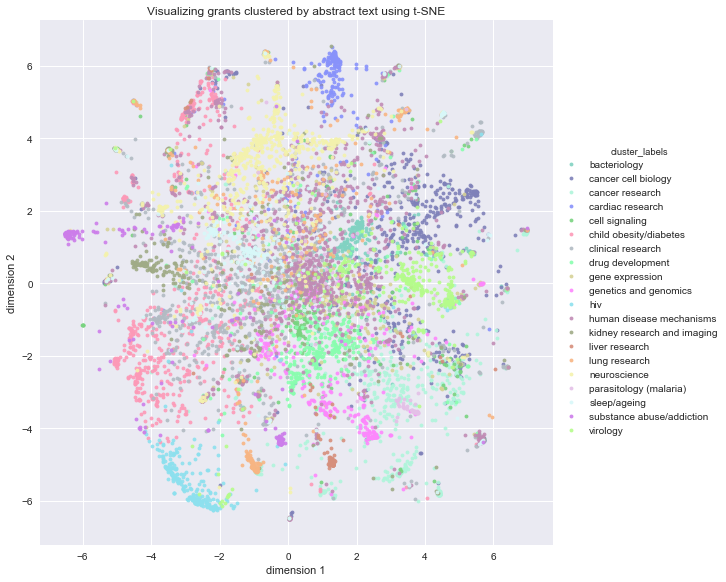

In [56]:
tsne_df = pd.DataFrame(fitted_tsnes[-1], columns = ['dimension 1', 'dimension 2'], index = subsamples.index)
tsne_df['cluster_labels'] = subsamples['cluster_labels']

ax = sns.lmplot('dimension 1', 'dimension 2', tsne_df, hue = 'cluster_labels',
                hue_order = hue_order,
                fit_reg = False, palette = cluster_colors, 
                size = 8, scatter_kws = {'alpha':0.9, 's':15})
_ = ax.set(title = 'Visualizing grants clustered by abstract text using t-SNE')

The sklearn documentation on t-SNE recommends performing an upstream dimensionality reduction technique such as PCA to reduce the number of dimensions to around 50 prior to using t-SNE to get better cluster visualization.

In [49]:
from sklearn.decomposition import PCA

In [396]:
pca = PCA(n_components = 50)
reduced = pca.fit_transform(tfidf_subsample.toarray())
print('{:.2%}'.format(pca.fit(tfidf_subsample.toarray()).explained_variance_ratio_.cumsum()[-1]) + \
      ' of the variance is explained by the first ' + str(50) + ' components')

21.35% of the variance is explained by the first 50 components


In [67]:
reduced_tsnes = []
for rate in learning_rates:
    tsne = TSNE(learning_rate = rate)
    reduced_tsnes.append(tsne.fit_transform(reduced))

In [70]:
#joblib.dump(reduced_tsnes, 'reduced_tsnes.pkl')
reduced_tsnes = joblib.load('reduced_tsnes.pkl')

['reduced_tsnes.pkl']

After fitting t-SNE on our PCA-reduced data, the learning rate that gave the most distinctly separated clusters was a learning rate of 500, which is shown below.

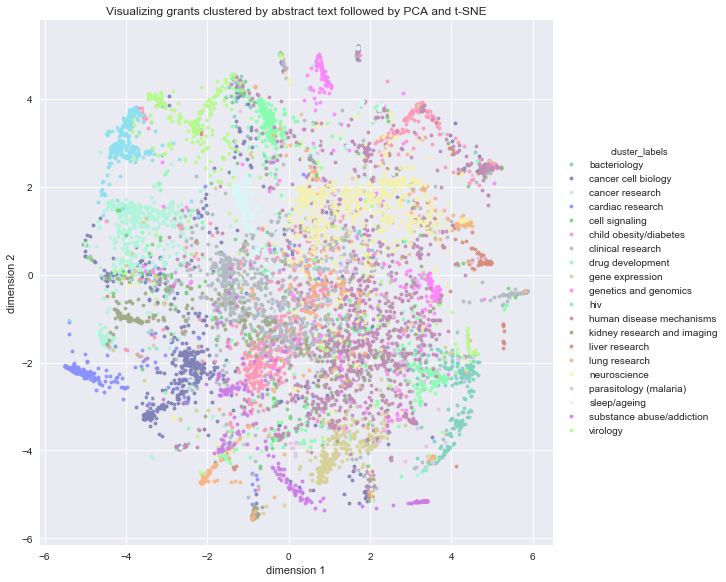

In [99]:
tsne_df = pd.DataFrame(reduced_tsnes[2], columns = ['dimension 1', 'dimension 2'], 
                       index = subsamples.index)
tsne_df['cluster_labels'] = subsamples['cluster_labels']

ax = sns.lmplot('dimension 1', 'dimension 2', tsne_df, hue = 'cluster_labels',
                hue_order = hue_order,
                fit_reg = False, palette = cluster_colors, 
                size = 8, scatter_kws = {'alpha':0.9, 's':15})
_ = ax.set(title = 'Visualizing grants clustered by abstract text followed by PCA and t-SNE')

## Predicting funding group based on grant abstract

For our initial analysis, we will attempt to predict which funding percentile group a grant falls into based on tf-idf of the abstracts. Although we will lose some information by grouping grants in this manner rather than running a regression, we will eventually include high-cardinal variables in our predictive models, and these are more easily incorporated in classification rather than regression tasks. Furthermore, because the majority of grants received very similar amounts of funding, the loss of information will not be too extreme. Finally, we want to be able to examine which features our model used in its prediction and will accomplish this using the lime package (see section below on model interpretation), which requires a categorical response variable.

In [77]:
X_train, X_test, y_train, y_test = train_test_split(phr_filtered_funds['phr_cleaned'].values, 
                                                    phr_filtered_funds['funding_group'].values, 
                                                    test_size = 0.25)

In [230]:
%time tfidf_train = vectorizer.fit_transform(X_train)
%time tfidf_test = vectorizer.transform(X_test)

CPU times: user 2min 46s, sys: 399 ms, total: 2min 46s
Wall time: 2min 47s
CPU times: user 54.8 s, sys: 86.3 ms, total: 54.9 s
Wall time: 54.9 s


For our first pass, we will train a simple naive multinomial Bayes model.

In [79]:
nb = MultinomialNB(alpha = 0.01)
nb.fit(tfidf_train, y_train)
pred = nb.predict(tfidf_test)
f1_score(y_test, pred, average = 'weighted')

MultinomialNB(alpha=0.01, class_prior=None, fit_prior=True)

0.43178573616858279

In [80]:
predictions = pd.DataFrame({'true':y_test, 'pred':pred})
predictions['correct_pred'] = predictions['pred'] == predictions['true']
predictions.head()

,pred,true,correct_pred
0,2.0,3.0,False
1,1.0,1.0,True
2,1.0,2.0,False
3,3.0,3.0,True
4,0.0,0.0,True


In [81]:
predictions['correct_pred'].value_counts(normalize = True)

False    0.563943
True     0.436057
Name: correct_pred, dtype: float64

In [82]:
predictions.groupby('true')['correct_pred'].value_counts(normalize = True)

true  correct_pred
0.0   False           0.622828
      True            0.377172
1.0   False           0.627857
      True            0.372143
2.0   False           0.605287
      True            0.394713
3.0   True            0.600274
      False           0.399726
Name: correct_pred, dtype: float64

Unsurprisingly, our naive classifier performed very poorly overall, although it is performing better than chance.

### Model interpretation

To get a sense of how our naive multinomial Bayes is classifying grants, we will use the [lime](https://github.com/marcotcr/lime) package to 'explain' individual predictions.

In [231]:
from lime import lime_text
from sklearn.pipeline import make_pipeline

In [214]:
pipeline = make_pipeline(vectorizer, nb)
class_names = ['low', 'med-low', 'med-high', 'high']

In [215]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names = class_names)

In [234]:
def explain_prediction(idx, X_test = X_test, pipeline = pipeline, tfidf_test = tfidf_test, 
                       y_test = y_test, class_names = class_names):
    
    '''
    Use lime package's explainer class to explain
    how grant was classified into a funding category
    based on abstract text.
    '''
    
    exp = explainer.explain_instance(X_test[idx], 
                                     pipeline.predict_proba, 
                                     num_features = 6, 
                                     labels = [0, 1, 2, 3])
    
    #label number of predicted class
    label_num = int(nb.predict(tfidf_test[idx]).reshape(1, -1)[0, 0])
    
    print('Grant number: {}'.format(idx))
    print('Predicted class: {}'.format(class_names[label_num]))
    print('True class: {}'.format(class_names[int(y_test[idx])]))
    
    exp.show_in_notebook(text = False)
    exp.show_in_notebook(text = X_test[idx], labels = (label_num,))

Let's look at one instance of each funding group (class) where our model correctly predicted the response class and one instance where the prediction was incorrect.

In [232]:
indices = []
groups = sorted(predictions['true'].unique().tolist())
for group in groups:
    for boolean in [True, False]:
        sample = predictions.ix[(predictions['true'] == group) & 
                                (predictions['correct_pred'] == boolean)].sample(1)
        indices.append(sample.index[0])

In [235]:
for idx in indices:
    explain_prediction(idx)

/usr/local/Cellar/python3/3.6.0/Frameworks/Python.framework/Versions/3.6/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Grant number: 6023
Predicted class: low
True class: low


Grant number: 37002
Predicted class: med-low
True class: low


Grant number: 30034
Predicted class: med-low
True class: med-low


Grant number: 36778
Predicted class: med-high
True class: med-low


Grant number: 7376
Predicted class: med-high
True class: med-high


Grant number: 15742
Predicted class: med-low
True class: med-high


Grant number: 30798
Predicted class: high
True class: high


Grant number: 23214
Predicted class: med-low
True class: high


## Predicting the amount of funding a grant was awarded

In our initial analysis we used a simple naive Multinomial Bayes model trained on our abstract tfidf matrix to predict a grant's funding group. We 

### Preparing design matrix for model training

**Not directly using tfidf matrix due to dimensionality concerns**

As we want to measure distance of each observation (grant) from the K-means cluster center, we will use the standard Euclidean distance.

In [23]:
from scipy.spatial.distance import cdist

#default is Euclidean distance
dist = cdist(tfidf_matrix.toarray(), km_fit.cluster_centers_)
dist.shape

(163532, 20)

Let's prepare a separate dataframe with the features we want to train on and our response variables. We will test both regression and classification methods.

In [33]:
df_modeling = pd.DataFrame(dist, columns = ['dist_' + str(i) for i in range(20)])

#include application_id column for identification
cols = ['application_type', 'fy', 'study_section', 
       'support_year', 'pi_ids', 'num_pis', 'funds', 'application_id']

for col in cols:
    df_modeling[col] = phr[col].tolist()

In addition to the distance of the grant from each cluster centroid, we will also include the following features:

* 

We don't need to include the cluster label/assignment because the distance from the cluster centroid includes that information.

In [34]:
print('~{0:.1f}% of grants have more than 1 PI listed'\
      .format((1 - phr['num_pis'].value_counts(normalize = True)[1.0]) * 100))

~13.4% of grants have more than 1 PI listed


In our original dataframe, if multiple PIs were associated with a single grant, then each PI was listed separately. At the beginning of our analysis, we combined these rows such that a single grant only appears once; however, information about individual PIs on these grants was lost. We will therefore also include the number of PIs as a feature to gain back some of this information.

Next we need to drop grants with unusually low funds and add funding group information.

In [35]:
df_modeling.drop(df_modeling.ix[df_modeling['funds'] < 1000].index, inplace = True)
df_modeling['funding_group'] = phr_filtered_funds['funding_group'].tolist()
df_modeling['funding_group'].replace({0:'low',
                                  1:'med-low',
                                  2:'med-high',
                                  3:'high'},
                                inplace = True)

Load file with organization DUNS number information and add it to the dataframe with the features we will use to train our model. Although one principal investigator (PI) can be associated with multiple organizations due to either joint appointments or a PI moving, for simplicity we will select the first organization the PI is associated with.

In [36]:
duns = pd.read_csv('pi_info.csv', compression = 'gzip',
                   usecols = ['pi_ids', 'org_duns'], dtype = str)

duns.drop_duplicates('pi_ids', inplace = True)
df_modeling = df_modeling.merge(duns, on = 'pi_ids', how = 'left')

Let's check for missing values.

In [37]:
df_modeling.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 163361 entries, 0 to 163360
Data columns (total 30 columns):
dist_0              163361 non-null float64
dist_1              163361 non-null float64
dist_2              163361 non-null float64
dist_3              163361 non-null float64
dist_4              163361 non-null float64
dist_5              163361 non-null float64
dist_6              163361 non-null float64
dist_7              163361 non-null float64
dist_8              163361 non-null float64
dist_9              163361 non-null float64
dist_10             163361 non-null float64
dist_11             163361 non-null float64
dist_12             163361 non-null float64
dist_13             163361 non-null float64
dist_14             163361 non-null float64
dist_15             163361 non-null float64
dist_16             163361 non-null float64
dist_17             163361 non-null float64
dist_18             163361 non-null float64
dist_19             163361 non-null float64
applicati

First let's convert support_year and num_pis to integers so they are represented as discrete, rather than continuous, variables.

In [38]:
for col in ['support_year', 'num_pis']:
    df_modeling[col] = df_modeling[col].astype(int)

A small number of grants are missing study section information or organization DUNS numbers. As these missing values represent less than 1% of the grants, we can simply impute these missing values. Prior to imputation, we will need to transform the study section, PI ID and organization DUNS variables, as all three are high-cardinal variables. High-cardinality refers to categorical variables with many distinct levels, which if dummy encoded could quickly blow-up our feature space. As can be seen below, these three variables have a very large number of distinct values.

In [39]:
card_cols = ['study_section', 'pi_ids', 'org_duns']
for col in card_cols:
    len(df_modeling[col].unique())

252

29052

1094

The pi_ids variable could be particularly problematic due to its extremely high-cardinality.

In [501]:
#counts number of times a unique PI ID is present
#in the dataset
counts_ids = df_modeling['pi_ids'].value_counts()

#how many PI IDs are represented 
#10 or fewer times in the dataset
low_counts = []
for i in range(1, 11):
    low_counts.append(len(counts_ids[counts_ids == i]))

sum_ = sum(low_counts)
per = sum_ / len(counts_ids) * 100

print('{0:} or {1:.1f}% of unique PI IDs only occur 10 or fewer times in the grants dataset'\
      .format(sum_, per))

25880 or 89.1% of unique PI IDs only occur 10 or fewer times in the grants dataset


If we include pi_ids as a feature, we will be dealing with a very sparse matrix. We will therefore drop pi_ids as a feature and transform study_section and org_duns to continuous ones to prevent problems of high-dimensionality when fitting our model. To prevent data leakage we will first split our data into train and test sets prior to any transformations.

In [40]:
df_modeling.drop('pi_ids', axis = 1, inplace = True)

In [41]:
response_cols = ['funds', 'funding_group']
feature_cols = [col for col in df_modeling if col not in response_cols]

model_xtrain, _, model_ytrain, _ = train_test_split(df_modeling[feature_cols],
                                                    df_modeling[response_cols],
                                                    test_size = 0.25, 
                                                    random_state = 42)

Let's merge the training sets back together and check the number of distinct values in the high-cardinal variables.

In [42]:
model_train = pd.concat([model_xtrain, model_ytrain], axis = 1)
card_cols.remove('pi_ids')
for col in card_cols:
    len(model_train[col].unique())

251

1066

Although some values of study_section and org_duns are not represented in the training set, they represent a low proportion of the total number of unique values. Therefore we can fill any unseen values in the test set with the mean.

Let's use the [supervised ratio](kdnuggets.com/2016/08/include-high-cardinality-attributes-predictive-model.html) (SR) technique to transform our high-cardinal variables to continuous ones. As we have 4 response categories (funding groups), we will have to create 4 columns representing the SR of each distinct value per response category.

In [43]:
study_sect_sr = nih.sr_transformation(model_train, 'study_section', 'funding_group')
duns_sr = nih.sr_transformation(model_train, 'org_duns', 'funding_group')

One concern with SR transformation of cardinal variables is when a particular value of the cardinal variable does not appear in all the response categories, e.g., a particular DUNS number may only be associated with grants that were highly funded. Let's take a look at the proportion of 0s in each funding group.

In [44]:
print('Proportion of 0s in each funding category by high-cardinal variable')
for df, name in zip([study_sect_sr, duns_sr], ['study sections:', 'DUNS #s:']):
    print()
    print(name)
    print()
    for col in df.columns:
        print(col + ': ' + str((df[col] == 0).sum() / len(df)))

Proportion of 0s in each funding category by high-cardinal variable

study sections:

low: 0.032
med-low: 0.048
med-high: 0.036
high: 0.028

DUNS #s:

low: 0.279812206573
med-low: 0.443192488263
med-high: 0.42441314554
high: 0.31455399061


In each funding group, there are a number of study sections and a large number of organizations (represented as DUNS numbers) that appear in fewer than all four funding groups. This could either be due to the study section or organization being associated with very few grants and is therefore associated with a given funding group by chance alone, or because the study section or organization truly has a high likelihood of being associated with a particular funding group(s). Let's check how often a study section or organization that falls into 3 or fewer funding groups appears in our dataset.

In [45]:
def find_zero_rows(df, value = 0):
    '''
    Finds the rows where at least one entry is equal to value (default 0).
    '''
    zero_rows = []
    for index, row in df.iterrows():
        for col in df.columns:
            if row[col] == value:
                zero_rows.append(index)
    
    return list(set(zero_rows))

def count_how_often(df1, df2, col):
    '''
    Output: dict where key = index of entry with zero value and 
    value = # times index appears in dataset
    '''
    
    zero_rows = find_zero_rows(df1)
    how_often = {}
    for row in zero_rows:
        len_ = len(df2.ix[df2[col] == row])
        how_often[row] = len_
    
    return how_often

In [360]:
how_often_duns = count_how_often(duns_sr, df_modeling, col = 'org_duns')
how_often_sect = count_how_often(study_sect_sr, df_modeling, col = 'study_section')

len(how_often_duns)
len(how_often_sect)

663

17

There are 663 organizations and 17 study sections that are associated with 3 or fewer categories of our response variable (funding group). We have several choices with how we deal with these entries. The first is to leave the transformed variables as they are and simply watch out for overfitting to these variables. We could also include a count variable of how often the instance appears in the dataset. Finally, we could treat low count instances as missing values and impute the normalized mean of each funding group.

For the study_section variable, we will simply include the SR transformed columns. There are relatively few instances that are not represented by all funding groups, so our model's performance should not be affected too severely. Furthermore, it is conceivable that certain study sections do tend to bias towards awarding a set amount of funds.

For the org_duns variable, let's impute the normalized mean of each column for those rows where all the instances were associated with only one funding group. We will not add a column with the org_duns counts as this does not seem a particularly useful feature and we want to limit our feature space as much as possible.

In [46]:
#setting value = 1 finds rows where 
#only 1 funding category is represented
zero_row_duns = find_zero_rows(duns_sr, value = 1)

norm_means = duns_sr.mean() / duns_sr.mean().sum()

#also get normalized mean for study sections
means_sect = study_sect_sr.mean() / study_sect_sr.mean().sum()

for row in zero_row_duns:
    duns_sr.loc[row] = norm_means

To prevent aliasing of our transformed variables, let's drop the 'low' columns and re-name the remaining columns.

In [47]:
duns_sr.drop('low', axis = 1, inplace = True)
study_sect_sr.drop('low', axis = 1, inplace = True)

duns_sr.columns = [str(col) + '_duns' for col in duns_sr.columns]
study_sect_sr.columns = [str(col) + '_sect' for col in study_sect_sr.columns]

Join the SR transformed variables with the original dataframe and drop the original non-transformed variables.

In [48]:
#rename index to column name
duns_sr.index.names = ['org_duns']
study_sect_sr.index.names = ['study_section']

duns_sr.reset_index(inplace = True)
study_sect_sr.reset_index(inplace = True)

df_modeling = df_modeling.merge(duns_sr, on = 'org_duns', how = 'left')
df_modeling = df_modeling.merge(study_sect_sr, on = 'study_section', how = 'left')

df_modeling.drop(['study_section', 'org_duns'], axis = 1, inplace = True)

In [49]:
df_modeling.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 163361 entries, 0 to 163360
Data columns (total 33 columns):
dist_0              163361 non-null float64
dist_1              163361 non-null float64
dist_2              163361 non-null float64
dist_3              163361 non-null float64
dist_4              163361 non-null float64
dist_5              163361 non-null float64
dist_6              163361 non-null float64
dist_7              163361 non-null float64
dist_8              163361 non-null float64
dist_9              163361 non-null float64
dist_10             163361 non-null float64
dist_11             163361 non-null float64
dist_12             163361 non-null float64
dist_13             163361 non-null float64
dist_14             163361 non-null float64
dist_15             163361 non-null float64
dist_16             163361 non-null float64
dist_17             163361 non-null float64
dist_18             163361 non-null float64
dist_19             163361 non-null float64
applicati

There were some grants in the original dataset from NIH where the DUNS number and/or study section was not listed. Let's impute these missing values with the mean of each column.

In [50]:
cols_to_fill = [col for col in list(df_modeling) if col.endswith('duns')] + \
[col for col in list(df_modeling) if col.endswith('sect')]
means = norm_means.drop('low').tolist() + means_sect.drop('low').tolist()

for col, mean in zip(cols_to_fill, means):
    df_modeling[col] = df_modeling[col].fillna(mean)

Let's re-split our data into train and test sets.

In [51]:
#re-specify feature columns
feature_cols = [col for col in df_modeling if col not in response_cols]

In [52]:
xtrain_df, xtest_df, ytrain_df, ytest_df = train_test_split(df_modeling[feature_cols],
                                                            df_modeling[response_cols],
                                                            test_size = 0.25, 
                                                            random_state = 42)

In [53]:
#save application_id columns for identification purposes
app_id_train = xtrain_df['application_id']
app_id_test = xtest_df['application_id']

xtrain_df.drop('application_id', axis = 1, inplace = True)
xtest_df.drop('application_id', axis = 1, inplace = True)

We will be using the polr function in the MASS library from R to fit an ordered logit model. R's functions take dataframes as input, and categorical variables should be coded as strings, not dummy variables. The response variable should also be included. Let's create train and test sets for R.

In [54]:
polr_train = pd.concat([xtrain_df, ytrain_df['funding_group']], axis = 1)
polr_xtest = xtest_df.copy()

In [55]:
R_cols = {
    'med-low_duns':'med_low_duns',
    'med-high_duns':'med_high_duns',
    'med-low_sect':'med_low_sect',
    'med-high_sect':'med_high_sect'
}

polr_train.rename(columns = R_cols, inplace = True)
polr_xtest.rename(columns = R_cols, inplace = True)

Finally, we will one-hot encode the remaining categorical variables for sklearn.

In [56]:
xtrain_df = pd.get_dummies(xtrain_df, drop_first = True)
xtest_df = pd.get_dummies(xtest_df, drop_first = True)

In [57]:
polr_train.shape, polr_xtest.shape
xtrain_df.shape, ytrain_df.shape
xtest_df.shape, ytest_df.shape

((122520, 31), (40841, 30))

((122520, 44), (122520, 2))

((40841, 44), (40841, 2))

### Model training

We can now train several models

* Multinomial Bayes
* Random Forest regression
* Ordered logit

#### Ordered logit (R)

For the ordered logit model we will use the polr function in R's MASS library. 

In [58]:
%load_ext rpy2.ipython

In [59]:
%%R -i polr_train -i polr_xtest

library(MASS)

#ensure fy and application_type are factors
polr_train$fy <- as.factor(polr_train$fy)
polr_train$application_type <- as.factor(polr_train$application_type)

#train initial model
polr_fit_main <- polr(factor(funding_group, levels = c('low', 'med-low', 'med-high', 'high'), ordered = TRUE)
                      ~ ., data = polr_train)

Let's take a look at which features the ordered logit model calculated were significant.

In [60]:
%%R

#store coefficients
ctable <- coef(summary(polr_fit_main))

#calculate and store p-values
p <- pnorm(abs(ctable[, 't value']), lower.tail = FALSE) * 2

#coefficients and p-values
cbind(ctable, 'p value' = p)

/usr/local/lib/python3.6/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: 
Re-fitting to get Hessian


  warnings.warn(x, RRuntimeWarning)


                         Value   Std. Error     t value       p value
dist_0              0.81457871 0.4692924965   1.7357591  8.260644e-02
dist_1              3.21567671 0.5223307687   6.1563992  7.441752e-10
dist_2              0.48755622 0.3877422080   1.2574236  2.086003e-01
dist_3             -2.15058498 0.2205557977  -9.7507524  1.831060e-22
dist_4              0.98755642 0.2388279022   4.1350128  3.549349e-05
dist_5              0.07929435 0.2855970797   0.2776441  7.812856e-01
dist_6              1.57121300 0.3996866048   3.9311125  8.455370e-05
dist_7             -0.61684362 0.7840047244  -0.7867856  4.314074e-01
dist_8            -13.41955425 0.5976506784 -22.4538426 1.173740e-111
dist_9             -1.07653026 0.3620957948  -2.9730537  2.948528e-03
dist_10            -0.82708980 0.3922818521  -2.1084070  3.499580e-02
dist_11            -2.45624589 0.2413569079 -10.1768203  2.516501e-24
dist_12            -2.54582613 0.3991350117  -6.3783583  1.789963e-10
dist_13            -

Support year, number of PIs and the transformed variables all have large or 0 p-values, suggesting problems with linear dependence among some features. Other features also have large p-values (including application_type3, which also has a 0 p-value). Let's test models with different features removed.

In [62]:
%%R

#remove terms to test significance
polr_fit_reduced <- polr(factor(funding_group, levels = c('low', 'med-low', 'med-high', 'high'), ordered = TRUE)
                         ~ . - support_year - num_pis - med_low_duns
                         - med_high_duns - high_duns - med_low_sect - med_high_sect - high_sect,
                        data = polr_train)

#remove terms to test significance
polr_fit_reduced2 <- polr(factor(funding_group, levels = c('low', 'med-low', 'med-high', 'high'), ordered = TRUE)
                         ~ . - support_year - num_pis - med_low_duns
                          - med_high_duns - high_duns - med_low_sect 
                          - med_high_sect - high_sect - application_type - fy,
                        data = polr_train)

anova(polr_fit_reduced2, polr_fit_reduced, polr_fit_main, test = 'Chisq')

Likelihood ratio tests of ordinal regression models

Response: factor(funding_group, levels = c("low", "med-low", "med-high", "high"), ordered = TRUE)
                                                                                                                                                                                                                                                                                                                                                                                                                                                                        Model
1 (dist_0 + dist_1 + dist_2 + dist_3 + dist_4 + dist_5 + dist_6 + dist_7 + dist_8 + dist_9 + dist_10 + dist_11 + dist_12 + dist_13 + dist_14 + dist_15 + dist_16 + dist_17 + dist_18 + dist_19 + application_type + fy + support_year + num_pis + med_low_duns + med_high_duns + high_duns + med_low_sect + med_high_sect + high_sect) - support_year - num_pis - med_low_duns - med_high_duns - hi

The p-values are likely being rounded to 0. 

Poor fit due to linear assumptions

We can check the prediction of

In [80]:
%%R

#store coefficients
ctable <- coef(summary(polr_fit_reduced2))

#calculate and store p-values
p <- pnorm(abs(ctable[, 't value']), lower.tail = FALSE) * 2

#coefficients and p-values
cbind(ctable, 'p value' = p)

                       Value Std. Error     t value       p value
dist_0             1.1208795  0.4394505   2.5506386  1.075258e-02
dist_1             5.5651441  0.4951262  11.2398507  2.598213e-29
dist_2             1.4110218  0.3629137   3.8880364  1.010585e-04
dist_3            -4.7283196  0.2062230 -22.9281907 2.432344e-116
dist_4             2.0347738  0.2240249   9.0828020  1.058150e-19
dist_5            -0.3807201  0.2715774  -1.4018843  1.609498e-01
dist_6             2.9613222  0.3779334   7.8355655  4.667371e-15
dist_7            -0.9397141  0.7407729  -1.2685589  2.045984e-01
dist_8           -21.0972575  0.5489597 -38.4313388  0.000000e+00
dist_9            -3.2841898  0.3430523  -9.5734368  1.034098e-21
dist_10           -2.1356120  0.3725322  -5.7326911  9.884958e-09
dist_11           -4.7913796  0.2242475 -21.3664834 2.740099e-101
dist_12           -3.7231910  0.3805726  -9.7831305  1.330309e-22
dist_13           -5.3390792  0.4643402 -11.4982064  1.346851e-30
dist_14   

In [81]:
%%R -o polr_pred

polr_pred <- predict(polr_fit_reduced2, polr_xtest, type = 'probs')

In [82]:
polr_pred

array([[ 0.17974421,  0.2342019 ,  0.28855614,  0.29749775],
       [ 0.273136  ,  0.2746269 ,  0.2541914 ,  0.19804569],
       [ 0.18192874,  0.23559941,  0.2880469 ,  0.29442495],
       ..., 
       [ 0.23873471,  0.26395939,  0.26896345,  0.22834245],
       [ 0.16607273,  0.22487865,  0.29118409,  0.31786453],
       [ 0.17718428,  0.23253247,  0.28912353,  0.30115972]])

#### Tree-based regression

In [77]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

In [64]:
X_train = xtrain_df.as_matrix()
y_train = ytrain_df['funds'].as_matrix()
X_test = xtest_df.as_matrix()
y_test = ytest_df['funds'].as_matrix()

In [65]:
rf = RandomForestRegressor(n_estimators = 500, n_jobs = -1)
rf = rf.fit_transform(X_train, y_train)

/usr/local/lib/python3.6/site-packages/sklearn/utils/deprecation.py:70: DeprecationWarning: Function transform is deprecated; Support to use estimators as feature selectors will be removed in version 0.19. Use SelectFromModel instead.
  warnings.warn(msg, category=DeprecationWarning)


array([[ 0.99153049,  0.99526344,  1.06407324, ...,  0.11397059,
         0.08089261,  0.        ],
       [ 1.02103699,  0.99251595,  1.08150564, ...,  0.27703762,
         0.0884808 ,  0.        ],
       [ 0.98203112,  0.95771008,  1.04068098, ...,  0.3148209 ,
         0.11090226,  0.        ],
       ..., 
       [ 1.01337239,  1.01722837,  1.05802271, ...,  0.22210026,
         0.22259136,  1.        ],
       [ 0.99092707,  1.00325965,  1.04929308, ...,  0.18213058,
         0.30980392,  0.        ],
       [ 1.02115443,  1.01847327,  0.91037359, ...,  0.31259294,
         0.69336384,  0.        ]])

In [78]:
rf_pred = rf.predict(X_test)
r2_score(y_test, rf_pred)

0.71599614486689978

Let's identify which features our naive random forest was using for the prediction task. The code to convert RandomForestRegressor.feature_importances to a dataframe with feature names and importance scores can be found [here](https://github.com/yuwie10/who-voted/blob/master/who_voted_functions.py).

In [86]:
import importlib.util

script = 'who_voted_functions.py'
path = '/Users/yuwenwu/who-voted/who_voted_functions.py'

spec = importlib.util.spec_from_file_location(script, path)
wv = importlib.util.module_from_spec(spec)
spec.loader.exec_module(wv)

In [191]:
#feature_cols.remove('application_id')
categ_cols = ['fy', 'application_type']
cont_cols = [col for col in feature_cols if col not in categ_cols]

important_features = wv.find_important_features(xtest_df, rf, categ_cols, cont_cols)

To make the features easier to interpret, let's replace the distance variable names (which represent the distance of each grant from the K-means cluster centroid) with the cluster label.

In [192]:
important_features.reset_index(drop = True, inplace = True)
for idx, feature in important_features['features'].iteritems():
    if feature.startswith('dist_'):
        important_features = important_features.replace(to_replace = feature, 
                                                        value = int(feature[5:]))

important_features = important_features.replace(cluster_labels)

Let's also combine the variables related to the DUNS number and study section of the grant.

In [193]:
def combine_card_scores(df, endswith, new_col, col1 = 'features', col2 = 'importance'):
    '''
    Combines the importance scores of transformed cardinal variables.
    '''
    scores = []
    for idx, feature in df[col1].iteritems():
        if feature.endswith(endswith):
            scores.append(df.loc[idx, col2])
            df = df[df[col1] != feature]
    
    sum_ = sum(scores)
    new_row = pd.DataFrame([[new_col, sum_]], columns = [col1, col2])
    df = df.append(new_row)
    
    return df.sort_values('importance', ascending = False)

In [194]:
important_features = combine_card_scores(important_features, '_sect', 'study_section')
important_features = combine_card_scores(important_features, '_duns', 'org_duns')

In [195]:
important_features

,features,importance
0,study_section,0.165063
1,application_type,0.105509
0,org_duns,0.097653
2,genetics and genomics,0.050801
4,support_year,0.039394
5,fy,0.034796
7,child obesity/diabetes,0.033794
8,cancer research,0.029876
9,num_pis,0.029827
10,cell signaling,0.028190


We could likely improve our r2_score by tuning hyperparameters or fitting a gradient boosted tree model. Let's try the latter.

In [197]:
from xgboost import XGBRegressor

In [ ]:
xgb = XGBRegressor()